# Library

In [1]:
from PIL import Image
import PIL
import cv2
import os
import random
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import glob
from tensorflow.keras import Input, Sequential
from tensorflow.keras.utils import Sequence
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.python.keras.layers.preprocessing.image_preprocessing import RandomFlip, RandomRotation
from U_net import get_unet
from random import shuffle
from shutil import copy

# Path

In [2]:
data_path = os.path.join('.', 'data')

train_images_path = os.path.join('.', 'data', 'train', 'images')
train_mask_path = os.path.join('.', 'data', 'train', 'mask')
test_images_path = os.path.join('.', 'data', 'test', 'images')
test_mask_path = os.path.join('.', 'data', 'test', 'mask')

paths = [train_images_path, train_mask_path, test_images_path, test_mask_path]

for path in paths:
    if os.path.isdir(path):
        pass
    else:
        os.makedirs(path)
        
mask_source_path = os.path.join('.', 'data', 'Masks')
img_source_path = os.path.join('.', 'data', 'Images')

# Load Image

In [3]:
tif_files = [file for file in os.listdir(img_source_path) if file.endswith('.tif')]
mask_tif = [file for file in os.listdir(mask_source_path) if file.endswith('.TIF')]

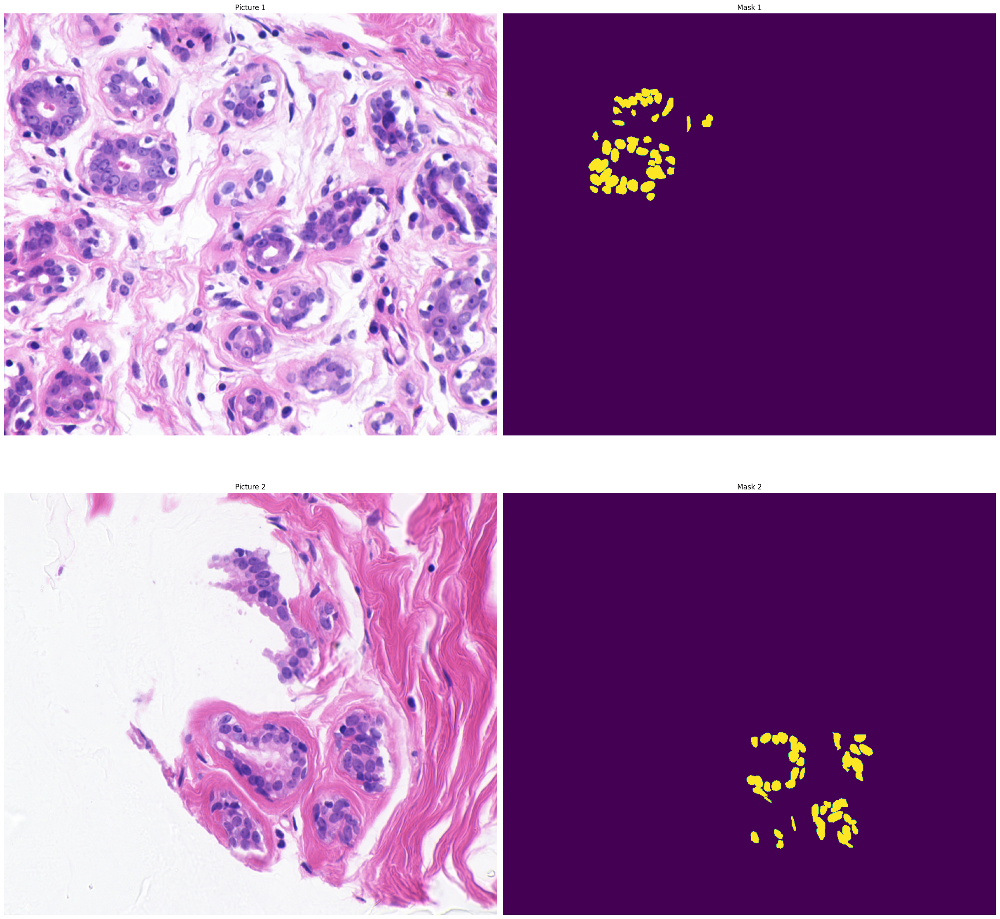

In [4]:
i, j = 0, 1
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(24,24))

axes.ravel()[0].imshow(Image.open(os.path.join(img_source_path, tif_files[i])))
axes.ravel()[0].set_title("Picture 1")
axes.ravel()[0].set_axis_off()
axes.ravel()[1].imshow(Image.open(os.path.join(mask_source_path, mask_tif[i])))
axes.ravel()[1].set_title("Mask 1")
axes.ravel()[1].set_axis_off()
axes.ravel()[2].imshow(Image.open(os.path.join(img_source_path, tif_files[j])))
axes.ravel()[2].set_title("Picture 2")
axes.ravel()[2].set_axis_off()
axes.ravel()[3].imshow(Image.open(os.path.join(mask_source_path, mask_tif[j])))
axes.ravel()[3].set_title("Mask 2")
axes.ravel()[3].set_axis_off()
plt.tight_layout()


# Data

In [5]:
# np.random.seed = 123

img_w = 256
img_h = 256
channels = 3

batch_size = 32

In [6]:
# class BCData(Sequence):
#     def __init__(self, batch_size,  img_height, img_width, img_channel, img_path, mask_path):
#         self.batch_size = batch_size
#         self.img_height = img_height
#         self.img_width = img_width
#         self.img_channel = img_channel
#         self.img_path = img_path
#         self.mask_path = mask_path
        
#     def __len__(self):
#         return len(self.img_path) // self.batch_size
    
#     def __getitem__(self, idx):
#         i = idx * self.batch_size
#         batch_img_paths = self.img_path[i:i+self.batch_size]
#         batch_mask_paths = self.mask_path[i:i+self.batch_size]
        
#         # resize the data
#         X = np.zeros((self.batch_size,  self.img_height, self.img_width,self.img_channel), dtype='float32')
#         for j, path in enumerate(batch_img_paths):
#             img = load_img(path, target_size=(self.img_height, self.img_width))
#             X[j] = img
#             X[j] /= 255
            
#         y = np.zeros((self.batch_size, self.img_height, self.img_width, 1), dtype=bool)
#         for j, path in enumerate(batch_mask_paths):
#             img = load_img(path, target_size=(self.img_height, self.img_width), color_mode="grayscale")
#             y[j] = np.expand_dims(img, 2) #make image from (160, 160) to (160, 160, 1) - adding dimension on axis=2
            
#         return X, y

In [6]:
class BCData(Sequence):
    def __init__(self, batch_size,  img_height, img_width, img_channel, img_path, mask_path):
        self.batch_size = batch_size
        self.img_height = img_height
        self.img_width = img_width
        self.img_channel = img_channel
        self.img_path = img_path
        self.mask_path = mask_path
        
    def __len__(self):
        return len(self.img_path) // self.batch_size
    
    def __getitem__(self, idx):
        i = idx * self.batch_size
        batch_img_paths = self.img_path[i:i+self.batch_size]
        batch_mask_paths = self.mask_path[i:i+self.batch_size]
        
        # resize the data
        X = np.zeros((self.batch_size,  self.img_height, self.img_width, self.img_channel), dtype='float32')
        for j, path in enumerate(batch_img_paths):
            img = cv2.imread(path)
            img = cv2.resize(img, (self.img_height, self.img_width))
            img = img / 255.0
            X[j] = img
        
        y = np.zeros((self.batch_size, self.img_height, self.img_width, 1), dtype='float32')
        for j, path in enumerate(batch_mask_paths):
            mask = cv2.imread(path)
            mask = cv2.cvtColor(mask, cv2.COLOR_BGR2GRAY)
            mask = cv2.resize(mask, (self.img_height, self.img_width)) 
            mask = np.expand_dims(mask, -1)
            mask = mask / 255.0
            y[j] = mask
            
        return X, y

In [7]:
def split_data(files, img_src_path, img_train_path, img_test_path, mask_src_path, mask_train_path, mask_test_path, split_size=0.8):
    n_sample = len(files)
    n_train = round(n_sample*split_size)
    shuffle(files)
    train_list = files[:n_train]
    test_list = files[n_train:]
    
    for file in train_list:
        img_path = os.path.join(img_src_path, file)
        copy(img_path, os.path.join(img_train_path, file))
        
        file = file.rsplit('_', 1)[0] + '.TIF'
        mask_path = os.path.join(mask_src_path, file)
        copy(mask_path, os.path.join(mask_train_path, file))

        
    for file in test_list:
        img_path = os.path.join(img_src_path, file)
        copy(img_path, os.path.join(img_test_path, file))

        file = file.rsplit('_', 1)[0] + '.TIF'
        mask_path = os.path.join(mask_src_path, file)
        copy(mask_path, os.path.join(mask_test_path, file))


    

In [8]:
# split_data(tif_files, img_source_path, train_images_path, test_images_path, mask_source_path,
#           train_mask_path, test_mask_path) 

## Augmentation

In [9]:
# data_augmentation = Sequential(
# [
#     RandomFlip("horizontal_and_vertical"),
#     RandomRotation(0.3)
# ])

In [8]:
#training data augementaion
folder_path = os.path.join('.', 'data', 'train', 'images')
save_path = os.path.join('.', 'data', 'train', 'images')

In [9]:
folder_path = os.path.join('.', 'data', 'train', 'mask')
save_path = os.path.join('.', 'data', 'train', 'mask')

In [10]:
#test data augmentaion
folder_path = os.path.join('.', 'data', 'test', 'images')
save_path = os.path.join('.', 'data', 'test', 'images')

In [11]:
folder_path = os.path.join('.', 'data', 'test', 'mask')
save_path = os.path.join('.', 'data', 'test', 'mask')

In [23]:
# for filename in os.listdir(folder_path):
#     img_path = os.path.join(folder_path, filename)
#     img = cv2.imread(img_path)
    
#     # augmentation type
#     flipped_img = cv2.flip(img, -1)
#     rotate_img = cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
# #     blur_img = cv2.GaussianBlur(img, (5,5), 0)
# #     cvt_colour_img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
# #     new_imgs = [flipped_img, rotate_img, blur_img, cvt_colour_img]
#     new_imgs = [flipped_img, rotate_img]

#     # save img
#     new_name1 = "filpped_" + filename
#     new_name2 = "rotated_" + filename
# #     new_name3 = "blur_" + filename
# #     new_name4 = "hsv_" + filename
#     new_names = [new_name1, new_name2]
    
#     for i in range(2):
#         new_img_path = os.path.join(save_path, new_names[i])
#         cv2.imwrite(new_img_path, new_imgs[i])

In [12]:
train_images_path = [os.path.join(train_images_path, file) for file in os.listdir(train_images_path)]
train_mask_path = [os.path.join(train_mask_path, file) for file in os.listdir(train_mask_path)]
test_images_path = [os.path.join(test_images_path, file) for file in os.listdir(test_images_path)]
test_mask_path = [os.path.join(test_mask_path, file) for file in os.listdir(test_mask_path)]

train_images_path = sorted(train_images_path)
train_mask_path = sorted(train_mask_path)
test_images_path = sorted(test_images_path)
test_mask_path = sorted(test_mask_path)


In [30]:
train_images_path

['.\\data\\train\\images\\filpped_ytma10_010704_benign1_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma10_010704_benign2_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma10_010704_benign3_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma10_010704_malignant1_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma10_010704_malignant3_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma12_010804_benign1_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma12_010804_benign2_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma12_010804_benign3_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma12_010804_malignant1_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma12_010804_malignant2_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma12_010804_malignant3_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma23_022103_benign1_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma23_022103_malignant1_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma23_022103_malignant2_ccd.tif',
 '.\\data\\train\\images\\filpped_ytma23_022103_maligna

In [29]:
train_mask_path

['.\\data\\train\\mask\\filpped_ytma10_010704_benign1.TIF',
 '.\\data\\train\\mask\\filpped_ytma10_010704_benign2.TIF',
 '.\\data\\train\\mask\\filpped_ytma10_010704_benign3.TIF',
 '.\\data\\train\\mask\\filpped_ytma10_010704_malignant1.TIF',
 '.\\data\\train\\mask\\filpped_ytma10_010704_malignant3.TIF',
 '.\\data\\train\\mask\\filpped_ytma12_010804_benign1.TIF',
 '.\\data\\train\\mask\\filpped_ytma12_010804_benign2.TIF',
 '.\\data\\train\\mask\\filpped_ytma12_010804_benign3.TIF',
 '.\\data\\train\\mask\\filpped_ytma12_010804_malignant1.TIF',
 '.\\data\\train\\mask\\filpped_ytma12_010804_malignant2.TIF',
 '.\\data\\train\\mask\\filpped_ytma12_010804_malignant3.TIF',
 '.\\data\\train\\mask\\filpped_ytma23_022103_benign1.TIF',
 '.\\data\\train\\mask\\filpped_ytma23_022103_malignant1.TIF',
 '.\\data\\train\\mask\\filpped_ytma23_022103_malignant2.TIF',
 '.\\data\\train\\mask\\filpped_ytma23_022103_malignant3.TIF',
 '.\\data\\train\\mask\\filpped_ytma49_042003_benign1.TIF',
 '.\\data\\train

In [13]:
train_gen = BCData(batch_size, img_h, img_w, 3, train_images_path, train_mask_path)
test_gen = BCData(6, img_h, img_w, 3, test_images_path, test_mask_path)

# Model

In [18]:
tf.keras.backend.clear_session()


In [14]:
inputs = Input(shape=(img_h, img_w, 3))


In [15]:
model = get_unet(inputs, 1, activation='sigmoid')

In [16]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 128, 128, 64) 0           conv2d_1[0][0]                   
______________________________________________________________________________________________

# Custom Callbacks

In [16]:
callbacks = ModelCheckpoint(filepath='model.{epoch:02d}-{loss:.4f}.h5',
                           save_freq='epoch', verbose=1, monitor='val_loss',
                           save_best_only=True)

In [29]:
class DisplayCallback(tf.keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=25):
        self.dataset = dataset
        self.epoch_interval = epoch_interval

    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i])
            plt.axis('off')
        plt.tight_layout()
        plt.show()

    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]

    def show_predictions(self, dataset, num=1):
        for image, mask in dataset:
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])

    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

# Custom Loss

In [18]:
import tensorflow.keras.backend as K

In [19]:
class BCEDiceLoss(tf.keras.losses.Loss):
  def __init__(self):
    super().__init__()

  def dice_coef(self, y_true, y_pred, smooth=1e-6):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    y_true_f = K.cast(y_true_f, 'float32')
    y_pred_f = K.cast(y_pred_f, 'float32')

    numerator = 2*(K.sum(y_true * y_pred)) + smooth
    denominator = K.sum(y_true) + K.sum(y_pred) + smooth
    dice = numerator / denominator

    return dice

  def call(self, y_true, y_pred, smooth=1e-6):
    y_true = K.flatten(y_true)
    y_pred = K.flatten(y_pred)

    y_true = K.cast(y_true, 'float32')
    y_pred = K.cast(y_pred, 'float32')

    bce_loss = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    dice = self.dice_coef(y_true, y_pred, smooth=1e-6)

    return (1-dice)+bce_loss

In [20]:
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    y_true_f = K.cast(y_true_f, 'float32')
    y_pred_f = K.cast(y_pred_f, 'float32')

    intersection = K.sum(y_true_f * y_pred_f)
    dice_coef_v = (2 * intersection + 1e-6) / (K.sum(y_true_f) + K.sum(y_pred_f) + 1e-6)
    return dice_coef_v

In [21]:
from tensorflow.keras.optimizers import SGD

In [27]:
from tensorflow.keras.models import load_model
model = load_model('BC_cancer_unet.h5', custom_objects={'BCEDiceLoss':BCEDiceLoss()}, compile=False)

In [30]:
model.compile(optimizer='adam', loss=BCEDiceLoss(), metrics=[dice_coef])

Epoch 1/151
4/4 [==============================] - 3s 540ms/step - loss: 1.1485 - dice_coef: 0.0996 - val_loss: 1.0851 - val_dice_coef: 0.1408
Epoch 2/151
4/4 [==============================] - 2s 552ms/step - loss: 0.9911 - dice_coef: 0.2057 - val_loss: 0.8927 - val_dice_coef: 0.2900
Epoch 3/151
4/4 [==============================] - 2s 656ms/step - loss: 0.8820 - dice_coef: 0.2859 - val_loss: 0.9100 - val_dice_coef: 0.2519
Epoch 4/151
4/4 [==============================] - 2s 574ms/step - loss: 0.7753 - dice_coef: 0.3354 - val_loss: 0.8315 - val_dice_coef: 0.2604
Epoch 5/151
4/4 [==============================] - 2s 664ms/step - loss: 0.7452 - dice_coef: 0.3387 - val_loss: 0.8237 - val_dice_coef: 0.2718
Epoch 6/151
4/4 [==============================] - 2s 661ms/step - loss: 0.6831 - dice_coef: 0.3967 - val_loss: 0.8390 - val_dice_coef: 0.2613
Epoch 7/151
4/4 [==============================] - 2s 659ms/step - loss: 0.6429 - dice_coef: 0.4328 - val_loss: 0.8450 - val_dice_coef: 0.2522

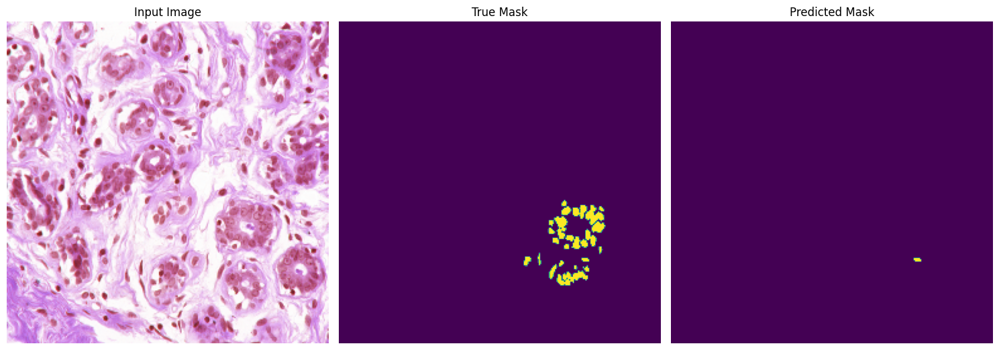

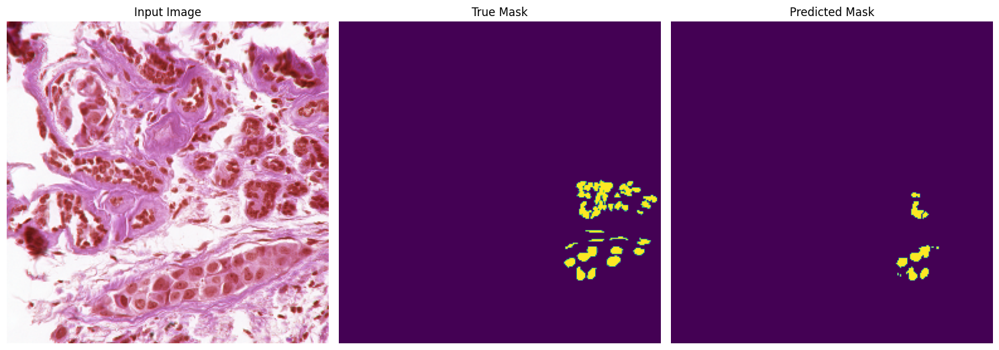

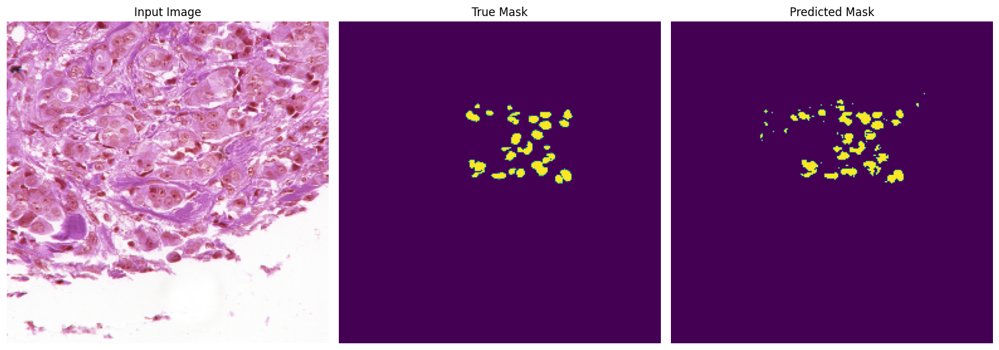

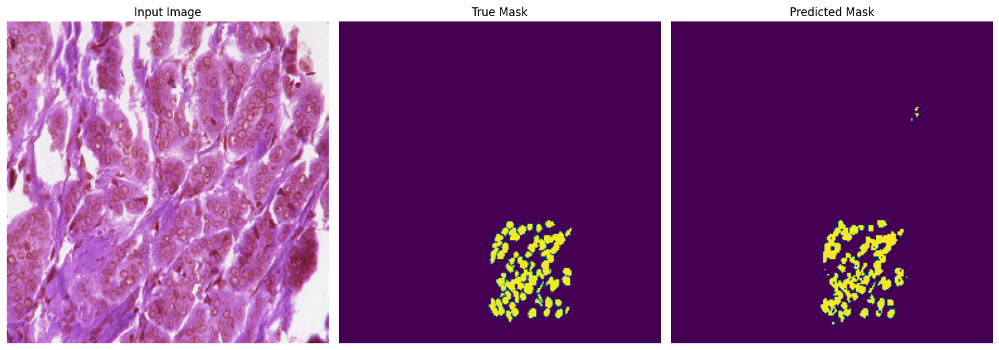


Sample Prediction after epoch 26

Epoch 27/151
4/4 [==============================] - 2s 530ms/step - loss: 0.2505 - dice_coef: 0.7838 - val_loss: 0.9447 - val_dice_coef: 0.1944
Epoch 28/151
4/4 [==============================] - 2s 567ms/step - loss: 0.2418 - dice_coef: 0.7924 - val_loss: 0.9427 - val_dice_coef: 0.2021
Epoch 29/151
4/4 [==============================] - 2s 560ms/step - loss: 0.2303 - dice_coef: 0.8026 - val_loss: 0.9546 - val_dice_coef: 0.1804
Epoch 30/151
4/4 [==============================] - 2s 547ms/step - loss: 0.2258 - dice_coef: 0.8056 - val_loss: 0.9452 - val_dice_coef: 0.1916
Epoch 31/151
4/4 [==============================] - 2s 560ms/step - loss: 0.2117 - dice_coef: 0.8190 - val_loss: 0.9671 - val_dice_coef: 0.1773
Epoch 32/151
4/4 [==============================] - 2s 547ms/step - loss: 0.2061 - dice_coef: 0.8240 - val_loss: 0.9514 - val_dice_coef: 0.1912
Epoch 33/151
4/4 [==============================] - 2s 661ms/step - loss: 0.1953 - dice_coef: 0.8332 

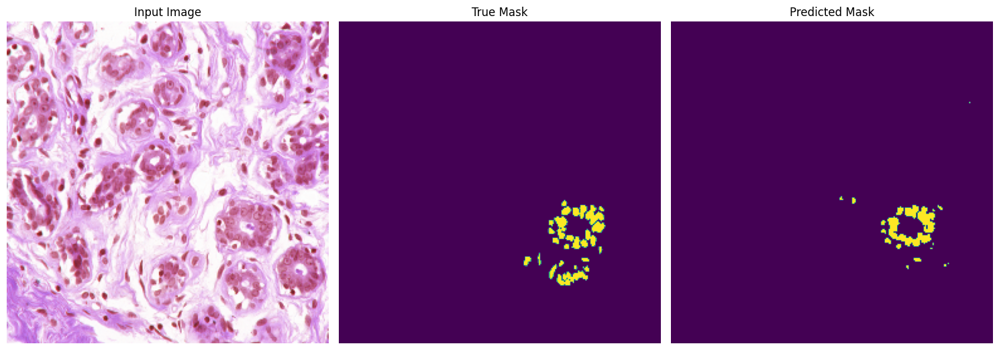

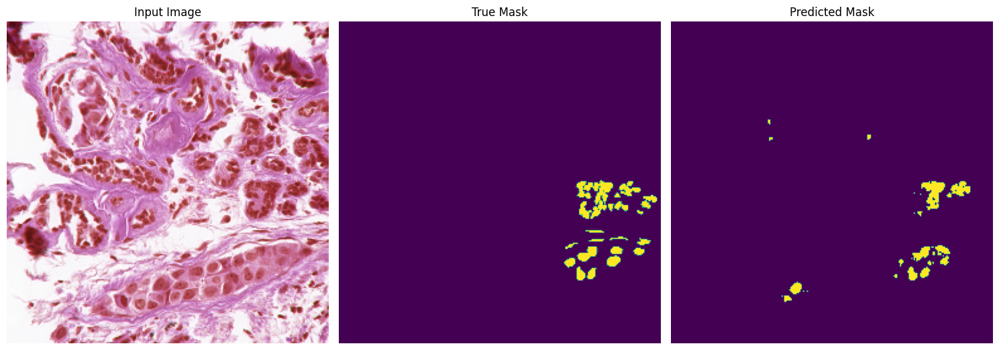

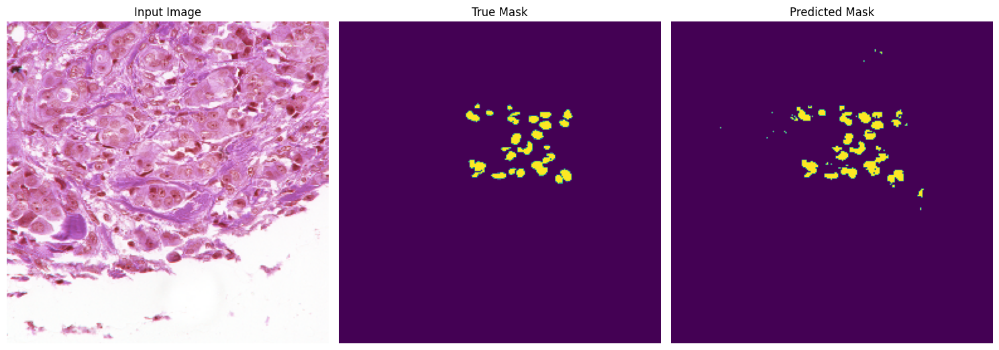

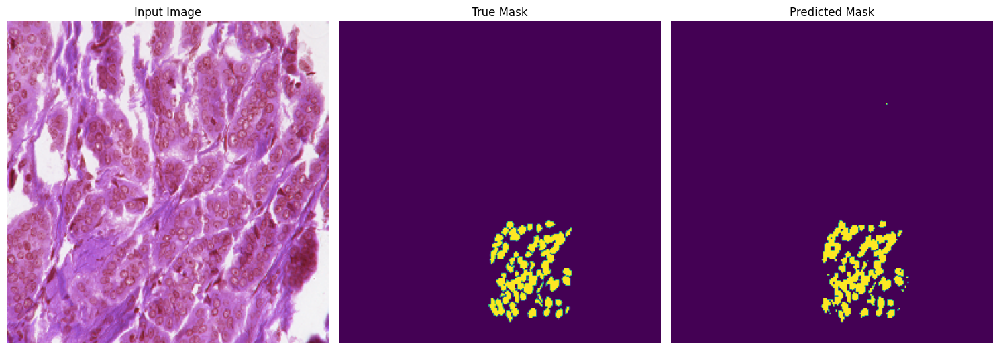


Sample Prediction after epoch 51

Epoch 52/151
4/4 [==============================] - 2s 514ms/step - loss: 0.2345 - dice_coef: 0.7970 - val_loss: 0.9271 - val_dice_coef: 0.2227
Epoch 53/151
4/4 [==============================] - 2s 555ms/step - loss: 0.2133 - dice_coef: 0.8156 - val_loss: 0.9795 - val_dice_coef: 0.1841
Epoch 54/151
4/4 [==============================] - 2s 555ms/step - loss: 0.2071 - dice_coef: 0.8211 - val_loss: 0.9626 - val_dice_coef: 0.1846
Epoch 55/151
4/4 [==============================] - 2s 568ms/step - loss: 0.2011 - dice_coef: 0.8270 - val_loss: 0.9689 - val_dice_coef: 0.1892
Epoch 56/151
4/4 [==============================] - 2s 553ms/step - loss: 0.1783 - dice_coef: 0.8455 - val_loss: 0.9555 - val_dice_coef: 0.1895
Epoch 57/151
4/4 [==============================] - 2s 551ms/step - loss: 0.1695 - dice_coef: 0.8532 - val_loss: 0.9659 - val_dice_coef: 0.1881
Epoch 58/151
4/4 [==============================] - 2s 558ms/step - loss: 0.1511 - dice_coef: 0.8697 

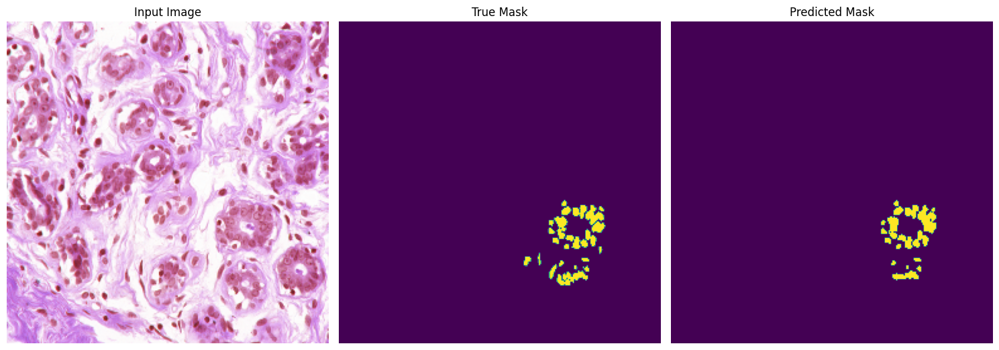

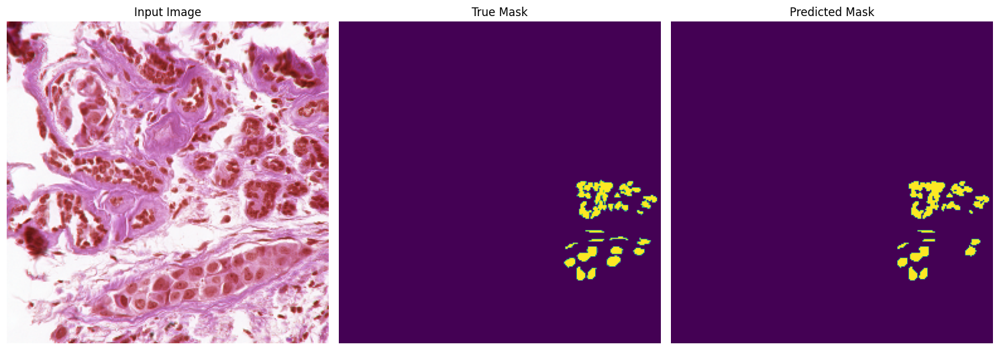

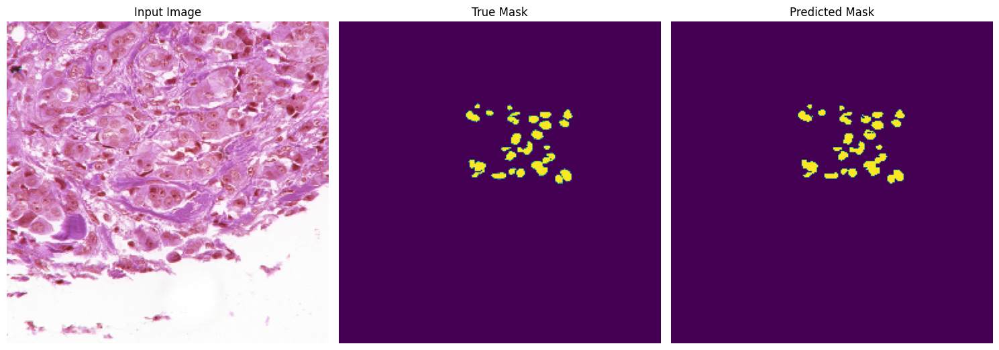

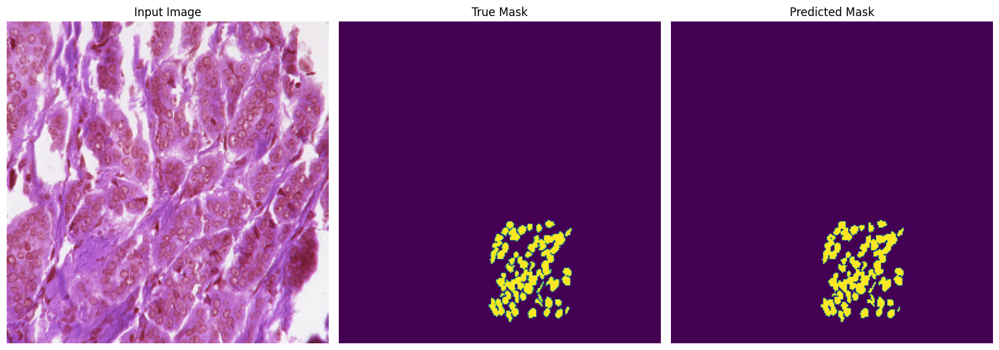


Sample Prediction after epoch 76

Epoch 77/151
4/4 [==============================] - 2s 514ms/step - loss: 0.0850 - dice_coef: 0.9283 - val_loss: 1.0226 - val_dice_coef: 0.1672
Epoch 78/151
4/4 [==============================] - 2s 561ms/step - loss: 0.0842 - dice_coef: 0.9292 - val_loss: 1.0458 - val_dice_coef: 0.1468
Epoch 79/151
4/4 [==============================] - 2s 550ms/step - loss: 0.0807 - dice_coef: 0.9323 - val_loss: 1.0220 - val_dice_coef: 0.1718
Epoch 80/151
4/4 [==============================] - 2s 655ms/step - loss: 0.0789 - dice_coef: 0.9339 - val_loss: 1.0334 - val_dice_coef: 0.1639
Epoch 81/151
4/4 [==============================] - 2s 572ms/step - loss: 0.0776 - dice_coef: 0.9351 - val_loss: 1.0484 - val_dice_coef: 0.1497
Epoch 82/151
4/4 [==============================] - 2s 572ms/step - loss: 0.0774 - dice_coef: 0.9351 - val_loss: 1.0265 - val_dice_coef: 0.1776
Epoch 83/151
4/4 [==============================] - 2s 555ms/step - loss: 0.0845 - dice_coef: 0.9283 

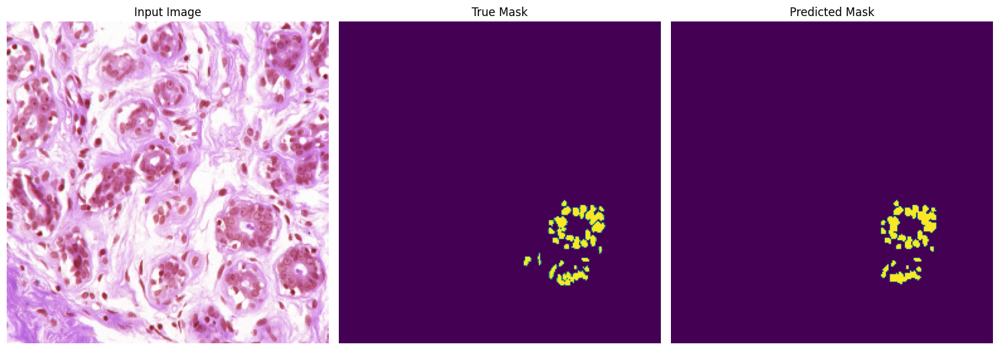

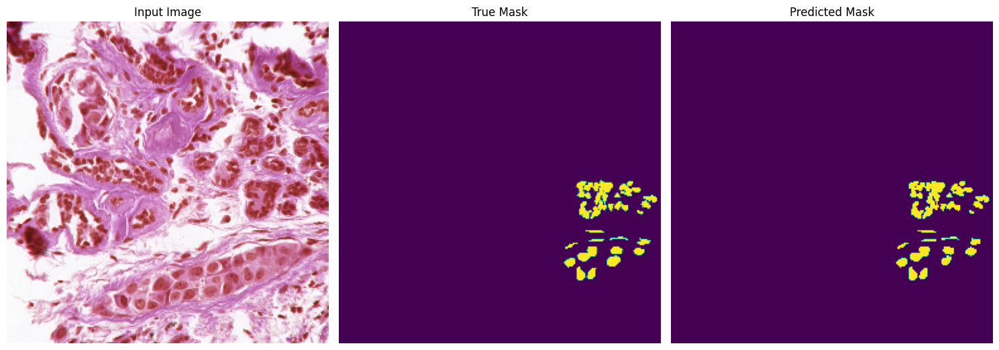

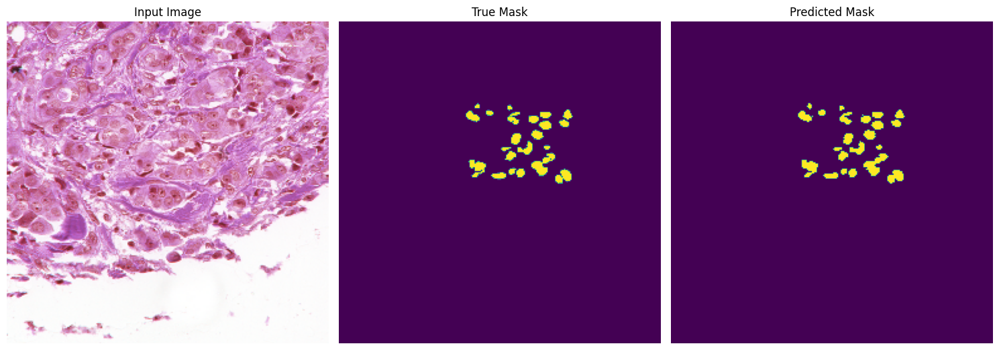

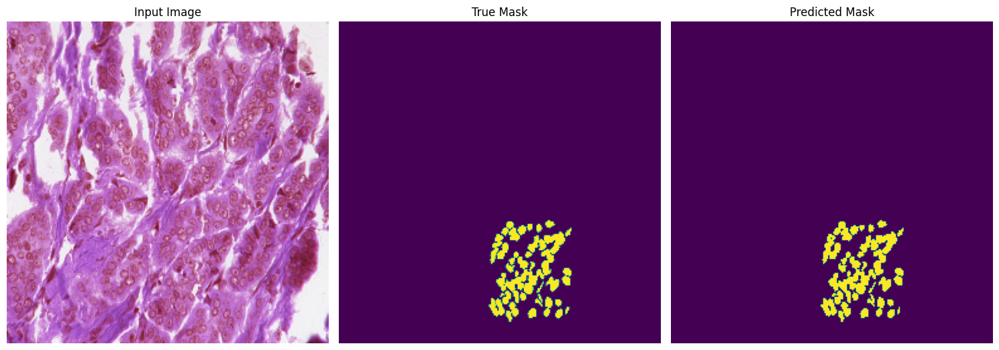


Sample Prediction after epoch 101

Epoch 102/151
4/4 [==============================] - 2s 533ms/step - loss: 0.0548 - dice_coef: 0.9547 - val_loss: 1.0726 - val_dice_coef: 0.1450
Epoch 103/151
4/4 [==============================] - 2s 673ms/step - loss: 0.0538 - dice_coef: 0.9555 - val_loss: 1.0584 - val_dice_coef: 0.1599
Epoch 104/151
4/4 [==============================] - 2s 678ms/step - loss: 0.0531 - dice_coef: 0.9562 - val_loss: 1.0749 - val_dice_coef: 0.1437
Epoch 105/151
4/4 [==============================] - 2s 566ms/step - loss: 0.0523 - dice_coef: 0.9569 - val_loss: 1.0633 - val_dice_coef: 0.1554
Epoch 106/151
4/4 [==============================] - 2s 552ms/step - loss: 0.0513 - dice_coef: 0.9578 - val_loss: 1.0747 - val_dice_coef: 0.1479
Epoch 107/151
4/4 [==============================] - 2s 660ms/step - loss: 0.0509 - dice_coef: 0.9580 - val_loss: 1.0673 - val_dice_coef: 0.1539
Epoch 108/151
4/4 [==============================] - 2s 657ms/step - loss: 0.0493 - dice_coef:

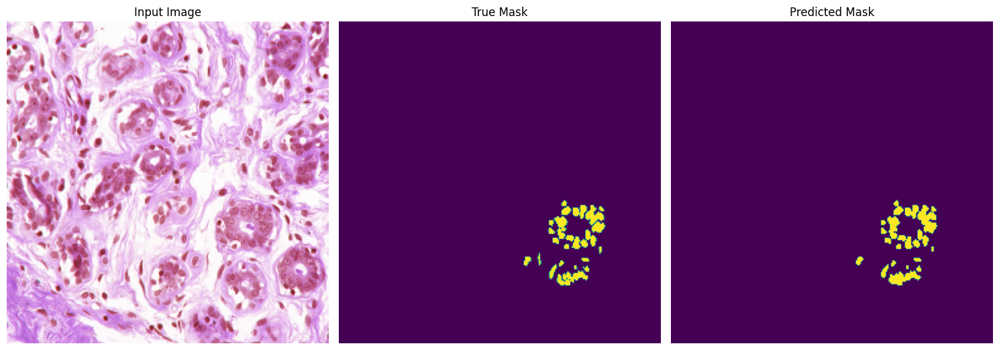

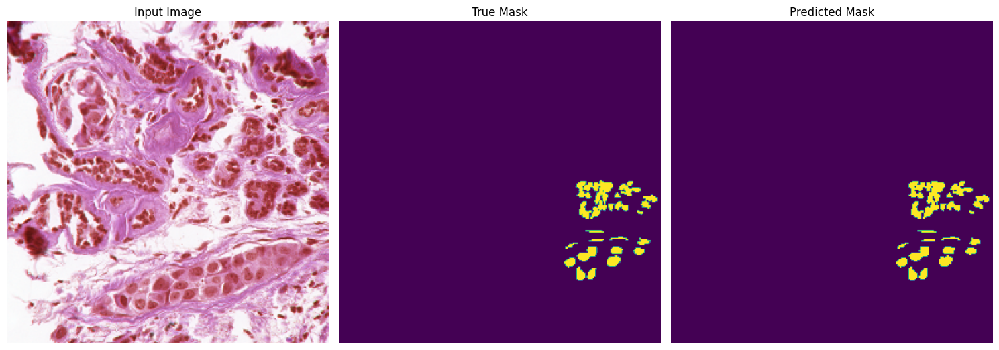

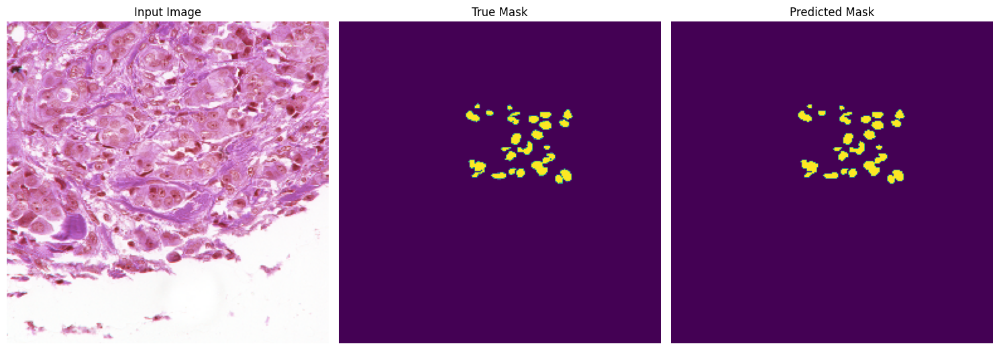

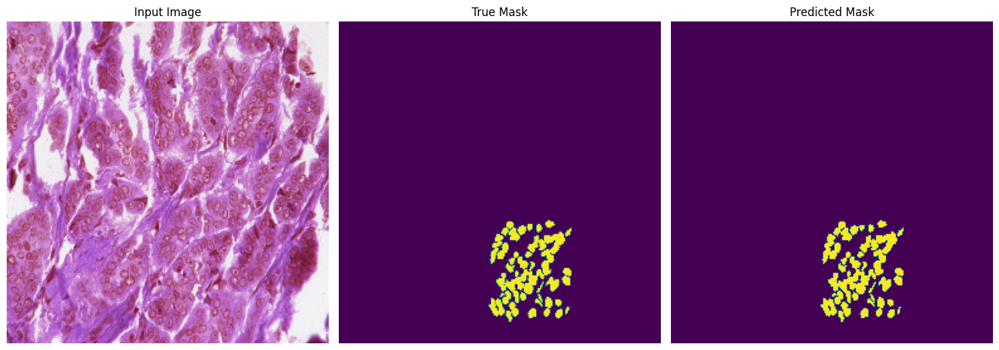


Sample Prediction after epoch 126

Epoch 127/151
4/4 [==============================] - 2s 539ms/step - loss: 0.0424 - dice_coef: 0.9652 - val_loss: 1.0959 - val_dice_coef: 0.1430
Epoch 128/151
4/4 [==============================] - 2s 546ms/step - loss: 0.0423 - dice_coef: 0.9651 - val_loss: 1.0908 - val_dice_coef: 0.1469
Epoch 129/151
4/4 [==============================] - 2s 654ms/step - loss: 0.0423 - dice_coef: 0.9650 - val_loss: 1.0965 - val_dice_coef: 0.1415
Epoch 130/151
4/4 [==============================] - 2s 556ms/step - loss: 0.0427 - dice_coef: 0.9648 - val_loss: 1.0900 - val_dice_coef: 0.1514
Epoch 131/151
4/4 [==============================] - 2s 567ms/step - loss: 0.0451 - dice_coef: 0.9624 - val_loss: 1.0804 - val_dice_coef: 0.1556
Epoch 132/151
4/4 [==============================] - 2s 565ms/step - loss: 0.0483 - dice_coef: 0.9595 - val_loss: 1.0984 - val_dice_coef: 0.1375
Epoch 133/151
4/4 [==============================] - 2s 566ms/step - loss: 0.0477 - dice_coef:

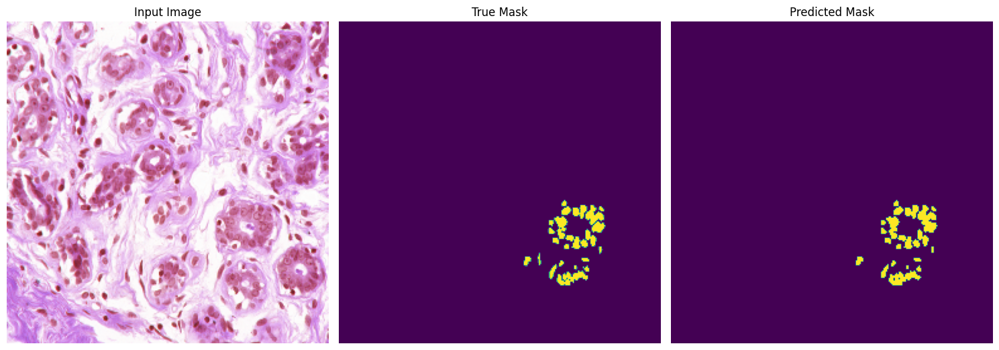

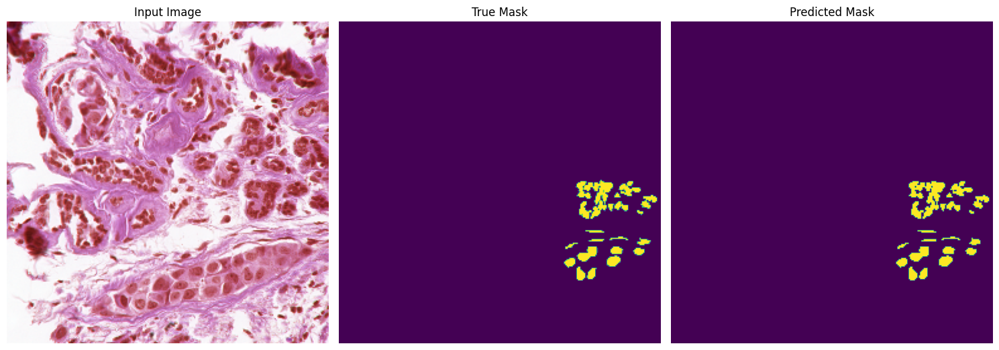

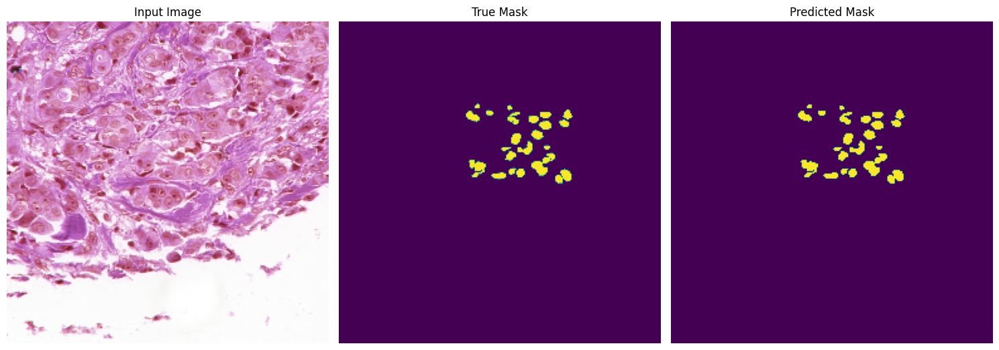

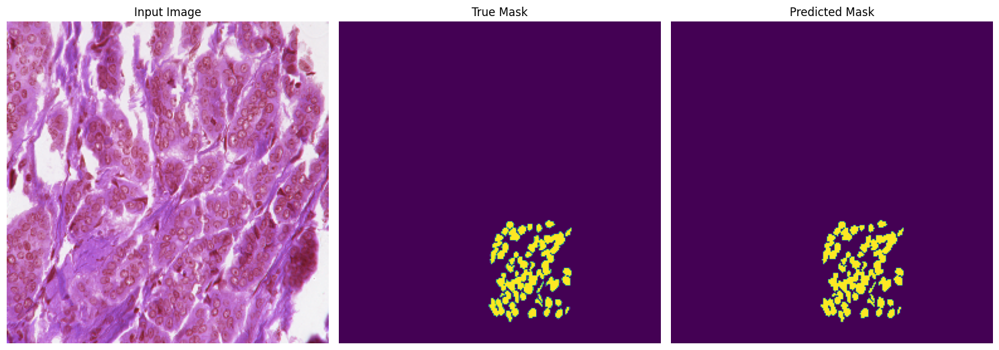


Sample Prediction after epoch 151



In [31]:
epochs=151
history = model.fit(train_gen, epochs=epochs, validation_data=test_gen, callbacks=[DisplayCallback(train_gen)])

In [32]:
model.save('BC_cancer_unet_2.h5')

In [33]:
dice_c = history.history['dice_coef']
val_dice_c = history.history['val_dice_coef']

loss = history.history['loss']
val_loss = history.history['val_loss']

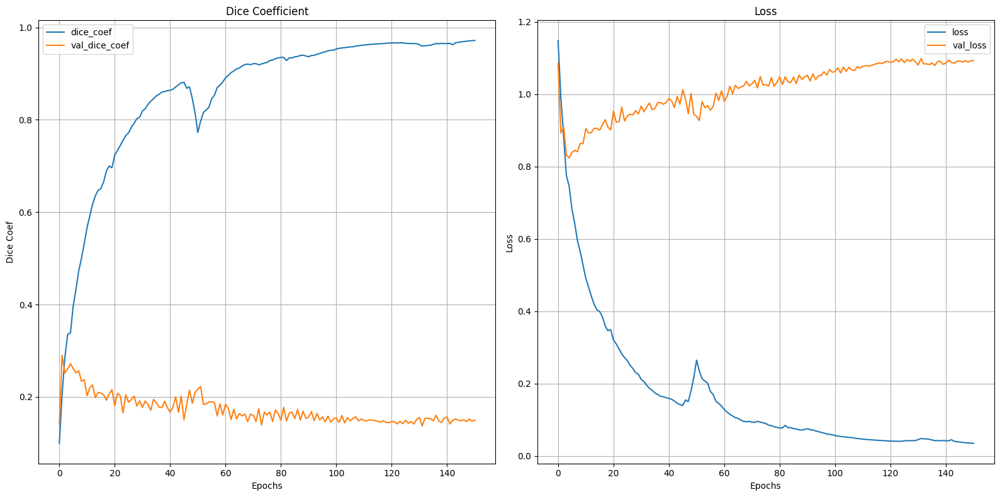

In [34]:
fig, axes = plt.subplots(1, 2, figsize=(16,8))
axes[0].plot(dice_c, label='dice_coef')
axes[0].plot(val_dice_c, label='val_dice_coef')
axes[0].set_xlabel('Epochs')
axes[0].set_ylabel('Dice Coef')
axes[0].set_title('Dice Coefficient')
axes[0].legend()
axes[0].grid()

axes[1].plot(loss, label='loss')
axes[1].plot(val_loss, label='val_loss')
axes[1].set_xlabel('Epochs')
axes[1].set_ylabel('Loss')
axes[1].set_title('Loss')
axes[1].legend()
axes[1].grid()

plt.tight_layout()

In [35]:
def display_images(trained_model, val_gen, i):
  pred = trained_model.predict(val_gen)
  fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15,15))
  axes[0].imshow(val_gen.__getitem__(0)[0][i])
  axes[0].set_title('Input Image')
  axes[0].set_axis_off()
  axes[1].imshow(val_gen.__getitem__(0)[1][i])
  axes[1].set_title('True Mask')
  axes[1].set_axis_off()
  axes[2].imshow(pred[i])
  axes[2].set_title('Predicted Mask')
  axes[2].set_axis_off()

  plt.tight_layout()

In [37]:
val_img_path = train_images_path[:10]
val_mask_path = train_mask_path[:10]

val_gen = BCData(6, img_h, img_w, 3, val_img_path, val_mask_path)


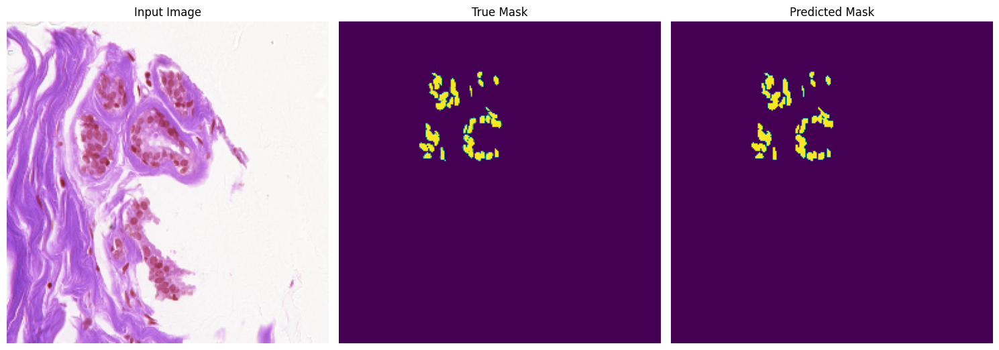

In [38]:
display_images(model, val_gen, 1)